# ACHR_3 Analysis Notebook

In [2]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

import numpy as np
import scipy
import pandas as pd
import tdt
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

import hypnogram as hp
import kd_analysis.main.utils as kd
import kd_analysis.main.plots as kp
import kd_analysis.main.hypno as kh
import neurodsp.plts.utils as dspu
import sleep_score_for_me.utils.ssfm_utils as ssu

bp_def = dict(delta=(1.5, 4), theta=(4, 8), sigma = (11, 16), beta = (13, 20), low_gamma = (40, 55), high_gamma = (65, 80), omega=(300, 700))

kd_ref = {}
kd_ref['echans'] = [1,2]
kd_ref['fchans']=[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
kd_ref['analysis_root'] = Path('/Volumes/opto_loc/Data/ACHR_PROJECT_MATERIALS/ACHR_3/ACHR_3-analysis-data')
kd_ref['tank_root'] = Path('/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK')

In [ ]:
def determine_good_thresholds(spg, mspg, good_hypno, bp_def, chan):
    #Calculate bandpower sets and pull out delta + omega
    spg = spg.copy().sel(channel=chan)
    mspg = mspg.copy()
    
    data_bp = kd.get_bp_set2(spg, bp_def)
    mus_bp = kd.get_bp_set2(mspg, bp_def)
    delta = data_bp.delta
    omega = mus_bp.omega
    
    good_nrem_delta = kh.keep_states(delta, good_hypno, ['NREM'])
    good_nrem_omega = kh.keep_states(omega, good_hypno, ['NREM'])
    
    dc1 = 5*np.std(good_nrem_delta.values) + good_nrem_delta.values.mean()
    dc2 = 3*np.std(good_nrem_delta.values) + good_nrem_delta.values.mean()
    oc1 = 3*np.std(good_nrem_omega.values) + good_nrem_omega.values.mean()
    
    return dc1, dc2, oc1

def starts_and_ends(s, minimum_duration=np.timedelta64(3, 's')):
    start_times = np.empty(0)
    end_times = np.empty(0)
    period = s.index[1] - s.index[0]

    s_trues = s[s==True]
    ix = s_trues.index
    ix_counter = np.arange(0, len(ix))

    try:
        for i in ix_counter:
            if (ix[i] - period) != ix[i-1]:
                start_times = np.append(start_times, ix[i])
            if (ix[i] + period) != ix[i+1]:
                end_times = np.append(end_times, (ix[i] + period))
            elif np.logical_and((ix[i] + period) == ix[i+1], (ix[i] - period) == ix[i-1]):
                pass 
    except IndexError:
        print('passing indexing error')
        pass
    try:
        end_times = np.append(end_times, (ix[ix_counter.max()] + period))
    except ValueError:
            print('ValueError raised when trying to create end_times... passing, so art_sne will likely be empty')
            pass
    return [(start_time, end_time)
            for start_time, end_time in zip(start_times, end_times)
            if end_time >= (start_time + minimum_duration)]


def build_art_hypno(states_and_times):
    """ Builds the actual formatted hypnogram once the artifact detection has already been done. 
    states_and_times --> series with only the timepoints corresponding sleep states (i.e. data that has already been 'scored')
    """

    # Get boolean series for each state
    art_bool = states_and_times == 'Art'
    good_bool = states_and_times == 'Good'

    # Use the boolean series to get start and end times for each state
    art_sne = starts_and_ends(art_bool)
    good_sne = starts_and_ends(good_bool)
    
    art_hyp = pd.DataFrame(columns = ['state', 'end_time', 'start_time', 'duration'])
    if len(art_sne)!=0:
        # Then we convert the start and end times for each state to a partial hypnogram
        art_hyp[['start_time', 'end_time']] = art_sne
        art_hyp['duration'] = art_hyp.end_time - art_hyp.start_time
        art_hyp['state'] = 'Art'
    elif len(art_sne)==0:
        print('There appear to be no artifacts for this channel, the entire hypnogram should be labelled as "good"')

    good_hyp = pd.DataFrame(columns = ['state', 'end_time', 'start_time', 'duration'])
    good_hyp[['start_time', 'end_time']] = good_sne
    good_hyp['duration'] = good_hyp.end_time - good_hyp.start_time
    good_hyp['state'] = 'Good'

    #Then we concat those and sort by the start_time 
    fin_hypno = pd.concat([art_hyp, good_hyp])
    fin_hypno = fin_hypno.sort_values('start_time').reset_index(drop=True)
       
    return fin_hypno


def artifactus_identicus_v1(dspg, mspg, bp_def, goods, good_channel):
    """Detects artifacts in a recording based on neural data and EMG, returns a hypnogram which marks all timepoints as 'Good' or 'Art'
    """
    # Here we get the Bandpower sets and pull out the delta and omega from the data and muscle, respectively
    data_bp = kd.get_bp_set2(dspg, bp_def)
    mus_bp = kd.get_bp_set2(mspg, bp_def)
    delta = data_bp.delta
    omega = mus_bp.omega
    
    # Get the thresholds for rejection from the 'good' dictionary
    dc1, dc2, oc1 = determine_good_thresholds(goods['spg'], goods['mspg'], goods['hypno'], bp_def, good_channel)
    
    #Here we build the DF for assigning the Artifact states:
    dt_ix = delta.datetime.values
    art_ser = pd.Series(delta, index=dt_ix)
    art_df = art_ser.to_frame(name='Delta')
    art_df['Omega'] = omega.values
    art_df['state'] = np.nan
    
    # Here we actually assign the artifact and good states for all timepoints
    art_df.loc[art_df.Delta >= dc1, 'state'] = 'Art'
    art_df.loc[np.logical_and(art_df.Delta >= dc2, art_df.Omega >= oc1), 'state'] = 'Art'
    art_df.loc[art_df.state!='Art', 'state'] = 'Good'  
    
    #Now we just build the hypnogram itself and return it
    art_hypno = build_art_hypno(art_df['state'])
    return hp.DatetimeHypnogram(art_hypno)

def artifactus_cleanicus(spg, hypno):
    """Takes in an spg with a given channel, and returns a clean version with all artifacts cleaned, based on the hypnogram for the same channel
    """
    spg_states = kh.add_states(spg, hypno)
    good_spg = spg_states.where(spg_states.state == 'Good')
    
    return good_spg

def artifactus_rejecticus(spg, mspg, bp_def, goods):
    master_spg = spg.copy()
    ref_spg = spg.copy()
    chans = master_spg.channel.values
    
    for chan in chans:
        working_spg = ref_spg.sel(channel=chan)
        art_hypno = artifactus_identicus_v1(working_spg, mspg, bp_def, goods, chan)
        clean_spg = artifactus_cleanicus(working_spg, art_hypno)
        
        # Here we take the clean_spg values and put them in the master_spg
        master_spg.loc[dict(channel=chan)] = clean_spg.values
        print('Channel-'+str(chan)+ ' Cleaned')
    return master_spg
    

In [ ]:
#Pulse times and numbers for calibration experiment on 12/5/21
cal_pulse_times = [(0, 0),
 (1, 36.5201408),
 (2, 395.50402560000003),
 (3, 490.70768128000003),
 (4, 566.81271296),
 (5, 706.79146496),
 (6, 830.4766976),
 (7, 923.4967347200001),
 (8, 1028.20081664),
 (9, 1110.9107712),
 (10, 1327.42586368),
 (11, 1545.248768),
 (12, 1675.74687744),
 (13, 1883.81134848),
 (14, 1932.29529088)]

# Paths, Definitions

In [ ]:
pth_x1_control = '/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK/ACHR_3-exp1-control'
pth_x1_control_bl = '/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK/ACHR_3-exp1-control-bl'

pth_x1_laser = '/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK/ACHR_3-exp1-laser'
pth_x1_laser_bl = '/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK/ACHR_3-exp1-laser-bl'

a3xc = {}
a3xl = {}

# Sleep Deprivation Experiments

## Load Data

In [ ]:
tt3 = a3xl['bl_espg'].sel(channel=1)

tt3_id = artifactus_identicus_v1(tt3, a3xl['bl_mspg'].sel(channel=1), bp_def, good_hypno)

tt3_clean = artifactus_cleanicus(tt3, tt3_id)

In [ ]:
#Load Laser Exp Data
a3xl['bl_e'], a3xl['bl_espg'] = kd.get_data_spg(pth_x1_laser_bl, store='EEGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)
a3xl['bl_f'], a3xl['bl_fspg'] = kd.get_data_spg(pth_x1_laser_bl, store='LFP_', t1=0, t2=42300, channel=kd_ref['fchans'], window_length=8)

a3xl['e'], a3xl['espg'] = kd.get_data_spg(pth_x1_laser, store='EEGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)
a3xl['f'], a3xl['fspg'] = kd.get_data_spg(pth_x1_laser, store='LFP_', t1=0, t2=42300, channel=kd_ref['fchans'], window_length=8)

a3xl['m'], a3xl['mspg'] = kd.get_data_spg(pth_x1_laser, store='EMGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)
a3xl['bl_m'], a3xl['bl_mspg'] = kd.get_data_spg(pth_x1_laser_bl, store='EMGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)

#Load Control Exp Data
a3xc['bl_e'], a3xc['bl_espg'] = kd.get_data_spg(pth_x1_control_bl, store='EEGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)
a3xc['bl_f'], a3xc['bl_fspg'] = kd.get_data_spg(pth_x1_control_bl, store='LFP_', t1=0, t2=42300, channel=[2,6,10,14], window_length=8)

a3xc['e'], a3xc['espg'] = kd.get_data_spg(pth_x1_control, store='EEGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)
a3xc['f'], a3xc['fspg'] = kd.get_data_spg(pth_x1_control, store='LFP_', t1=0, t2=42300, channel=[2,6,10,14], window_length=8)

a3xc['m'], a3xc['mspg'] = kd.get_data_spg(pth_x1_control, store='EMGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)
a3xc['bl_m'], a3xc['bl_mspg'] = kd.get_data_spg(pth_x1_control_bl, store='EMGr', t1=0, t2=42300, channel=kd_ref['echans'], window_length=8)

In [ ]:
hypno_path = '/Volumes/opto_loc/Data/ACHR_PROJECT_MATERIALS/ACHR_3/analysis/ACHR_3-good-hypno.txt'
good_hypno = kh.load_hypno_file(hypno_path, cbl_start)

In [ ]:
cbl_start = a3xc['bl_espg'].datetime.values.min()
lbl_start = a3xl['bl_espg'].datetime.values.min()
cx_start = a3xc['espg'].datetime.values.min()
lx_start = a3xl['espg'].datetime.values.min()

In [ ]:
fsel_cbl = a3xc['bl_fspg'].sel(channel=[2, 6, 10, 14])
fsel_cx = a3xc['fspg'].sel(channel=[2, 6, 10, 14])
fsel_lbl = a3xl['bl_fspg'].sel(channel=[2, 6, 10, 14])
fsel_lx = a3xl['fspg'].sel(channel=[2, 6, 10, 14])

In [ ]:
clean = {}
good_eeg = {}
good_lfp = {}

gmus = a3xc['bl_mspg'].sel(channel=1)

good_eeg['spg'] = a3xc['bl_espg']
good_eeg['mspg'] = gmus
good_eeg['hypno'] = good_hypno

good_lfp['spg'] = a3xc['bl_fspg']
good_lfp['mspg'] = gmus
good_lfp['hypno'] = good_hypno

In [ ]:
clean['ble_cx'] = artifactus_rejecticus(a3xc['bl_espg'], a3xc['bl_mspg'].sel(channel=1), bp_def, good_eeg)
clean['blf_cx'] = artifactus_rejecticus(fsel_cbl, a3xc['bl_mspg'].sel(channel=1), bp_def, good_lfp)
clean['ble_lx'] = artifactus_rejecticus(a3xl['bl_espg'], a3xl['bl_mspg'].sel(channel=1), bp_def, good_eeg)
clean['blf_lx'] = artifactus_rejecticus(fsel_lbl, a3xl['bl_mspg'].sel(channel=1), bp_def, good_lfp)

clean['ecx'] = artifactus_rejecticus(a3xc['espg'], a3xc['mspg'].sel(channel=1), bp_def, good_eeg)
clean['fcx'] = artifactus_rejecticus(fsel_cx, a3xc['mspg'].sel(channel=1), bp_def, good_lfp)
clean['elx'] = artifactus_rejecticus(a3xl['espg'], a3xl['mspg'].sel(channel=1), bp_def, good_eeg)
clean['flx'] = artifactus_rejecticus(fsel_lx, a3xl['mspg'].sel(channel=1), bp_def, good_lfp)

## LFP Data

In [ ]:
hour = pd.to_timedelta(1, unit='h')

In [ ]:
h5 = pd.to_timedelta(5, unit='h')
h6 = pd.to_timedelta(6, unit='h')

(0.0, 250000.0)

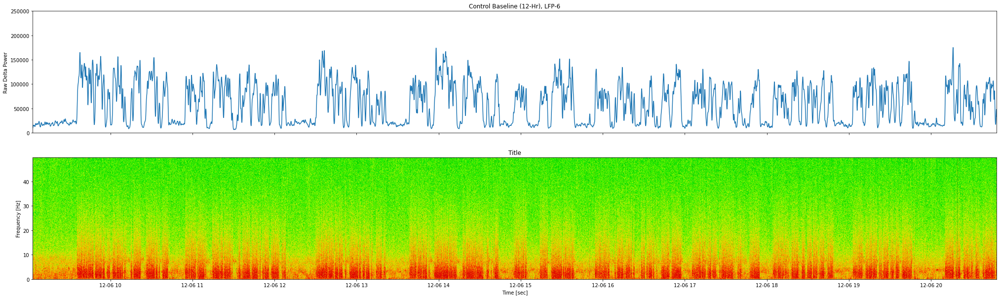

In [164]:
chan = 6
y = 250000
band = 'delta'
b, s = kp.plot_bp_and_spectro(clean['blf_cx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('Control Baseline (12-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 250000.0)

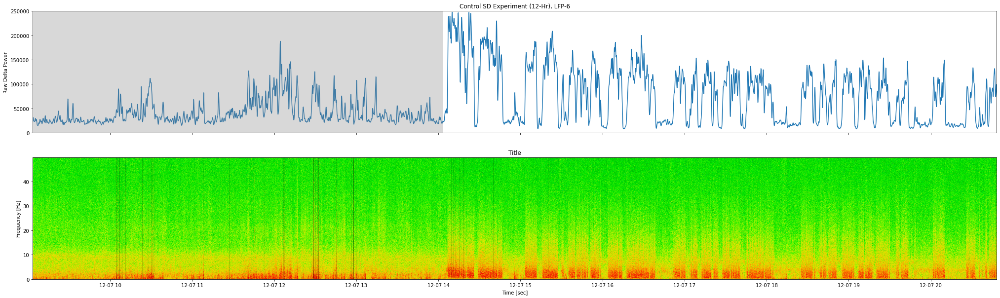

In [163]:
chan=6
y = 250000
b, s = kp.plot_bp_and_spectro(clean['fcx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('Control SD Experiment (12-Hr), LFP-'+str(chan))
b.axvspan(
    cx_start,
    cx_start+h5,
    alpha=0.3,
    color='gray',
    zorder=1000,
    ec="none",
)
b.set_ylim(0, y)

(0.0, 500000.0)

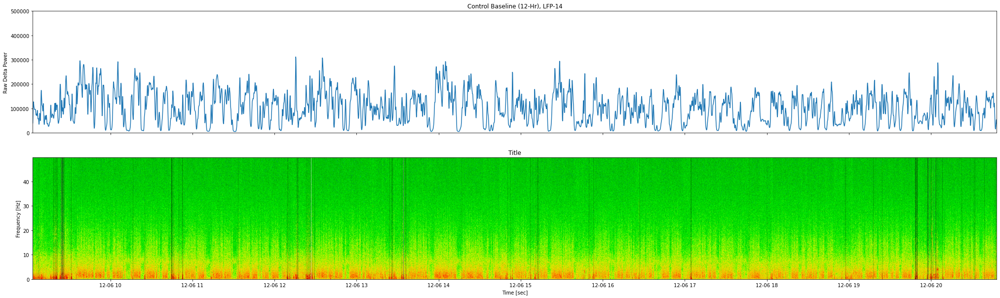

In [165]:
chan = 14
y = 500000
band = 'delta'
b, s = kp.plot_bp_and_spectro(clean['blf_cx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('Control Baseline (12-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 500000.0)

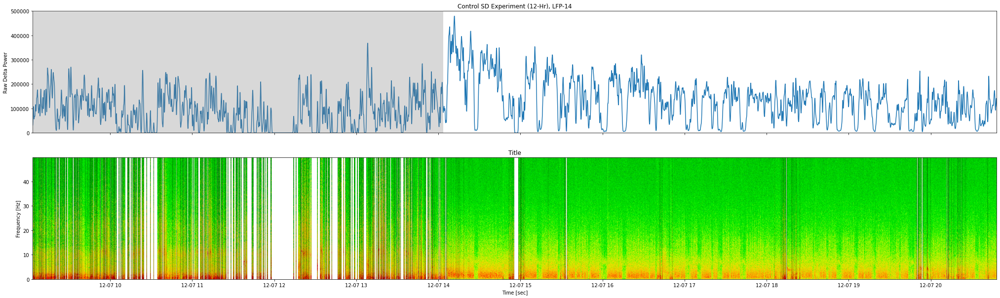

In [166]:
chan=14
y = 500000
b, s = kp.plot_bp_and_spectro(clean['fcx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('Control SD Experiment (12-Hr), LFP-'+str(chan))
b.axvspan(
    cx_start,
    cx_start+h5,
    alpha=0.3,
    color='gray',
    zorder=1000,
    ec="none",
)
b.set_ylim(0, y)

(0.0, 250000.0)

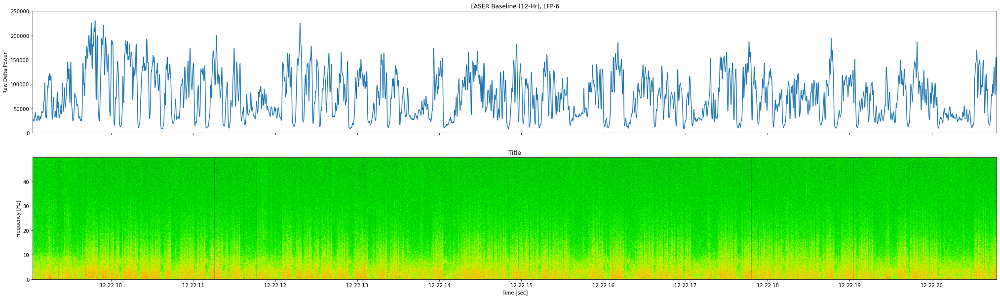

In [168]:
chan = 6
y = 250000
band = 'delta'
b, s = kp.plot_bp_and_spectro(clean['blf_lx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('LASER Baseline (12-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 250000.0)

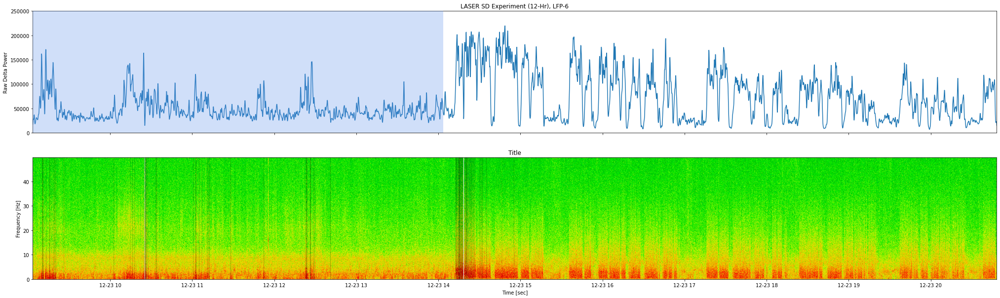

In [169]:
chan=6
y = 250000
b, s = kp.plot_bp_and_spectro(clean['flx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('LASER SD Experiment (12-Hr), LFP-'+str(chan))
b.axvspan(
    lx_start,
    lx_start+h5,
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_ylim(0, y)

(0.0, 500000.0)

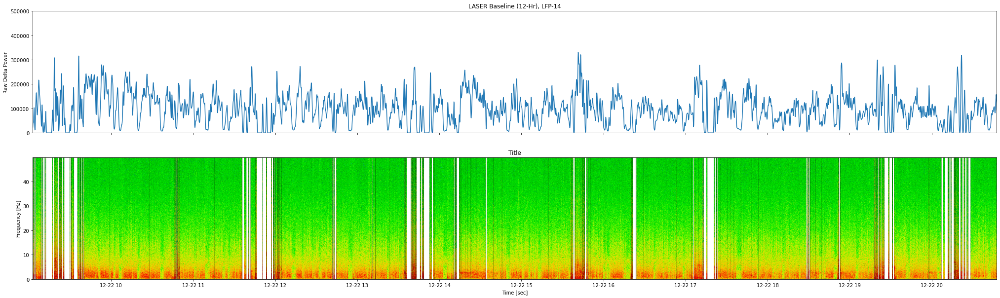

In [170]:
chan = 14
y = 500000
band = 'delta'
b, s = kp.plot_bp_and_spectro(clean['blf_lx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('LASER Baseline (12-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 500000.0)

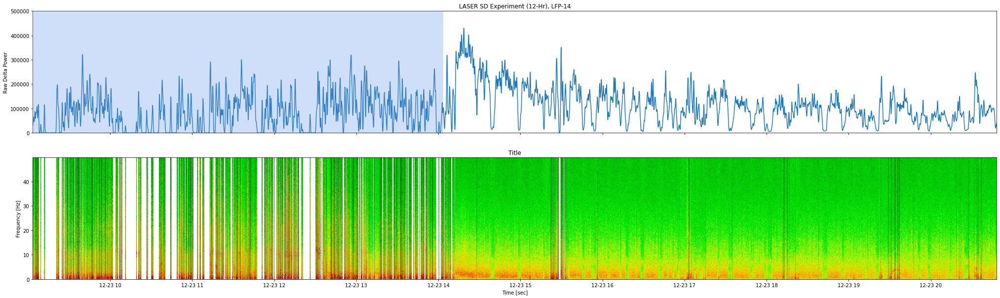

In [171]:
chan=14
y = 500000
b, s = kp.plot_bp_and_spectro(clean['flx'], chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title('LASER SD Experiment (12-Hr), LFP-'+str(chan))
b.axvspan(
    lx_start,
    lx_start+h5,
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_ylim(0, y)

## EEG Data

(0.0, 6000.0)

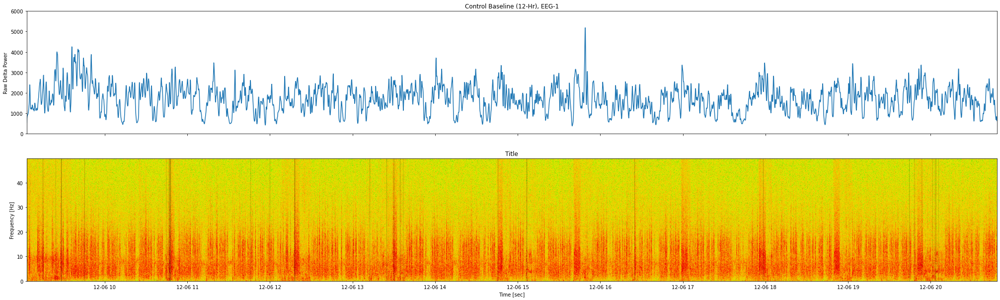

In [172]:
chan=1
y=6000
b, s = kp.plot_bp_and_spectro(clean['ble_cx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("Control Baseline (12-Hr), EEG-"+str(chan))
b.set_ylim(0,y)

(0.0, 6000.0)

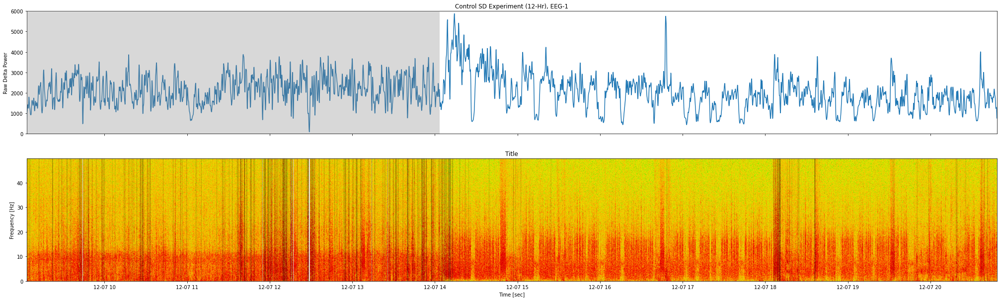

In [173]:
chan=1
y=6000
b, s = kp.plot_bp_and_spectro(clean['ecx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("Control SD Experiment (12-Hr), EEG-"+str(chan))
b.axvspan(
    cx_start,
    cx_start+h5,
    alpha=0.3,
    color='gray',
    zorder=1000,
    ec="none",
)
b.set_ylim(0,y)

(0.0, 8000.0)

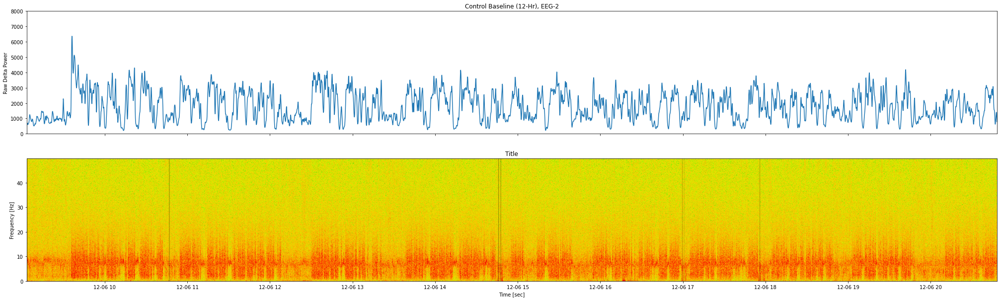

In [174]:
chan=2
y=8000
b, s = kp.plot_bp_and_spectro(clean['ble_cx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("Control Baseline (12-Hr), EEG-"+str(chan))
b.set_ylim(0,y)

(0.0, 8000.0)

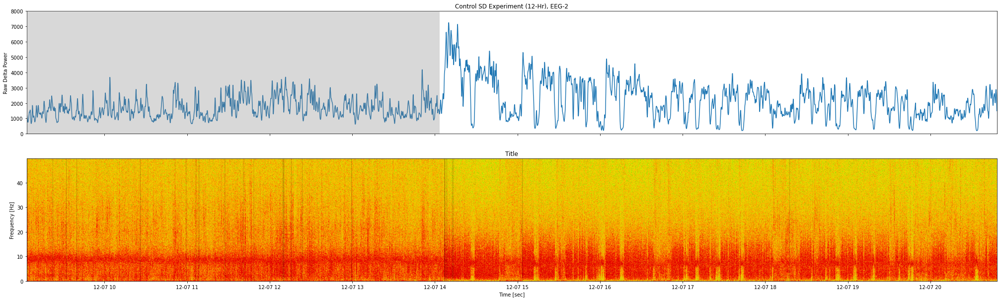

In [175]:
chan=2
y=8000
b, s = kp.plot_bp_and_spectro(clean['ecx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("Control SD Experiment (12-Hr), EEG-"+str(chan))
b.axvspan(
    cx_start,
    cx_start+h5,
    alpha=0.3,
    color='gray',
    zorder=1000,
    ec="none",
)
b.set_ylim(0,y)

(0.0, 6000.0)

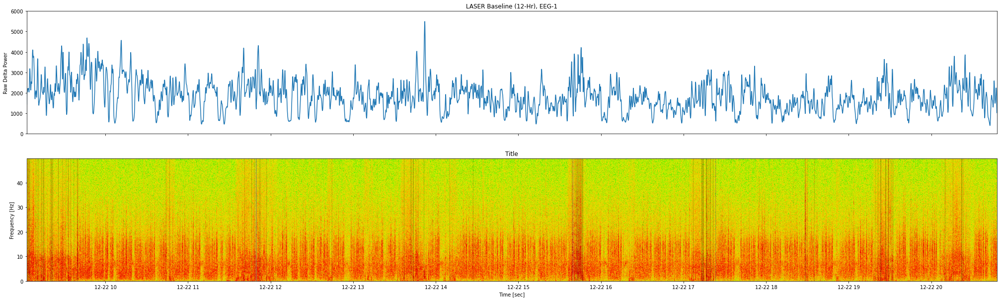

In [176]:
chan=1
y=6000
b, s = kp.plot_bp_and_spectro(clean['ble_lx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("LASER Baseline (12-Hr), EEG-"+str(chan))
b.set_ylim(0,y)

(0.0, 6000.0)

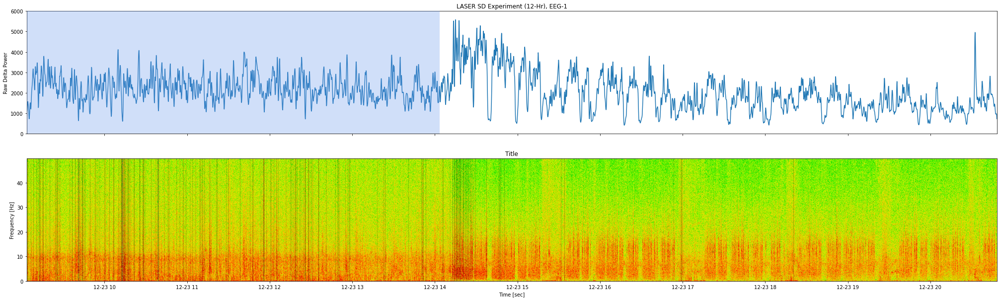

In [177]:
chan=1
y=6000
b, s = kp.plot_bp_and_spectro(clean['elx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("LASER SD Experiment (12-Hr), EEG-"+str(chan))
b.axvspan(
    lx_start,
    lx_start+h5,
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_ylim(0,y)

(0.0, 8000.0)

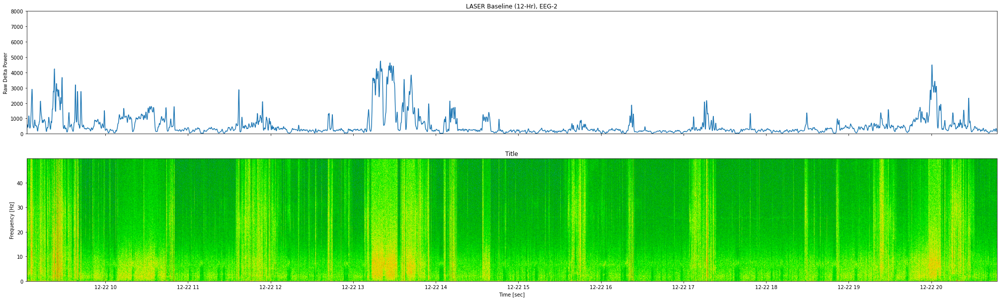

In [178]:
chan=2
y=8000
b, s = kp.plot_bp_and_spectro(clean['ble_lx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("LASER Baseline (12-Hr), EEG-"+str(chan))
b.set_ylim(0,y)

(0.0, 8000.0)

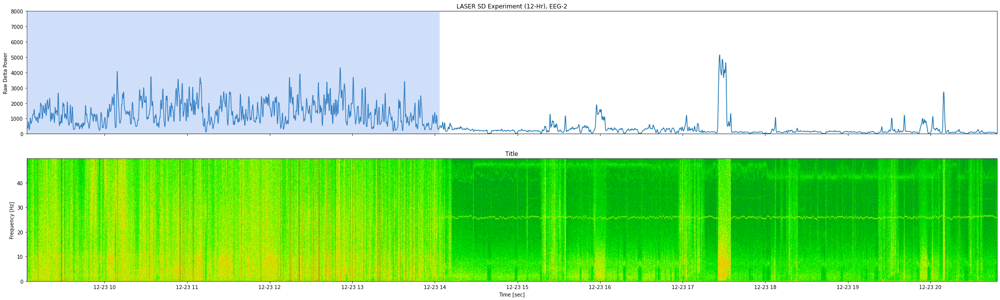

In [179]:
chan=2
y=8000
b, s = kp.plot_bp_and_spectro(clean['elx'], chan=chan, hyp=None, bp_def=bp_def, band='delta')
b.set_title("LASER SD Experiment (12-Hr), EEG-"+str(chan))
b.axvspan(
    lx_start,
    lx_start+h5,
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_ylim(0,y)

# Continous Stimulation Experiments

In [ ]:
pth_x2 = '/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK/ACHR_3-exp2'
pth_x2_bl = '/Volumes/opto_loc/Data/ACHR_3/ACHR_3_TANK/ACHR_3-exp2-bl'

In [ ]:
#Load data
a3x2 = {}
a3x2['e'], a3x2['espg'] = kd.get_data_spg(pth_x2, store='EEGr', t1=0, t2=42300, channel=kd_ref['echans'])
a3x2['ebl'], a3x2['ebl_spg'] = kd.get_data_spg(pth_x2_bl, store='EEGr', t1=0, t2=43200, channel=kd_ref['echans'])

a3x2['f'], a3x2['fspg'] = kd.get_data_spg(pth_x2, store='LFP_', t1=0, t2=42300, channel=[2, 6, 10, 14])
a3x2['fbl'], a3x2['fbl_spg'] = kd.get_data_spg(pth_x2_bl, store='LFP_', t1=0, t2=43200, channel=[2,6,10,14])

In [ ]:
a3x2['m'], a3x2['mspg'] = kd.get_data_spg(pth_x2, store='EMGr', t1=0, t2=42300, channel=[1,2], sel_chan=1)
a3x2['mbl'], a3x2['mbl_spg'] = kd.get_data_spg(pth_x2_bl, store='EMGr', t1=0, t2=43200, channel=[1,2], sel_chan=1)

In [ ]:
clean['2e'] = artifactus_rejecticus(a3x2['espg'], a3x2['mspg'], bp_def, good_eeg)
clean['2ebl'] = artifactus_rejecticus(a3x2['ebl_spg'], a3x2['mbl_spg'], bp_def, good_eeg)

In [ ]:
clean['2f'] = artifactus_rejecticus(a3x2['fspg'], a3x2['mspg'], bp_def, good_lfp)
clean['2fbl'] = artifactus_rejecticus(a3x2['fbl_spg'], a3x2['mbl_spg'], bp_def, good_lfp)

In [ ]:
def t2dt(times, start_time):
    dt = np.empty(0)
    for time in times:
        time_delta = pd.to_timedelta(time, unit='seconds')
        datetime = time_delta + start_time
        dt = np.append(dt, datetime)
    return dt

In [ ]:
st = np.datetime64('2021-12-15T09:04:33.999993880')
times = [1268, 19313]
las = t2dt(times, start_time=st)

## LFP Plots

(0.0, 120000.0)

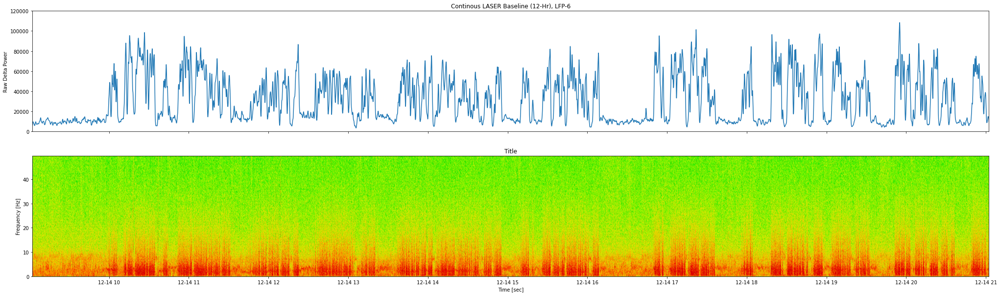

In [180]:
band='delta'
chan=6
y = 120000
b, s = kp.plot_bp_and_spectro(clean['2fbl'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.set_title('Continous LASER Baseline (12-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 120000.0)

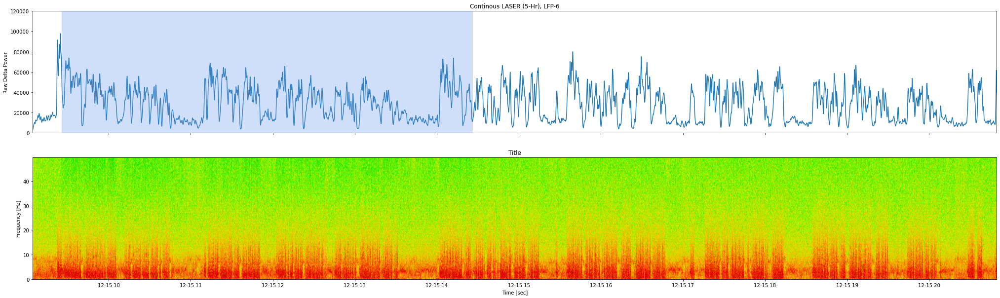

In [181]:
band='delta'
chan=6
y=120000
b, s = kp.plot_bp_and_spectro(clean['2f'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.axvspan(
    las[0],
    las[1],
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_title('Continous LASER (5-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 200000.0)

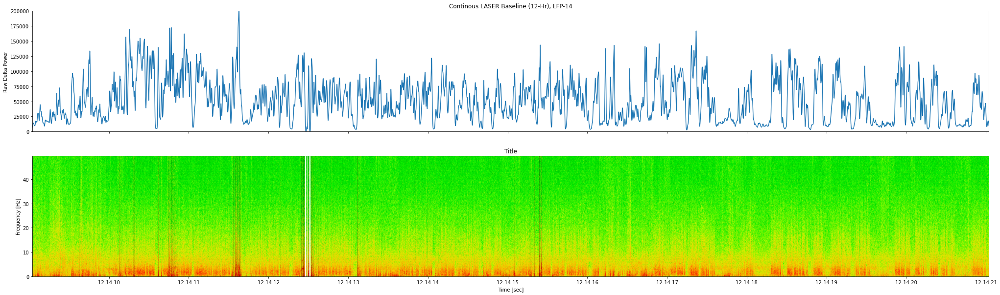

In [182]:
band='delta'
chan=14
y = 200000
b, s = kp.plot_bp_and_spectro(clean['2fbl'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.set_title('Continous LASER Baseline (12-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

(0.0, 200000.0)

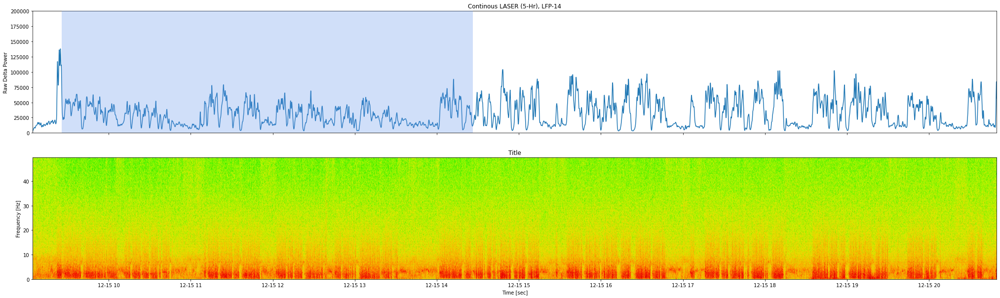

In [183]:
band='delta'
chan=14
y=200000
b, s = kp.plot_bp_and_spectro(clean['2f'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.axvspan(
    las[0],
    las[1],
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_title('Continous LASER (5-Hr), LFP-'+str(chan))
b.set_ylim(0,y)

## EEG Plots

(0.0, 3500.0)

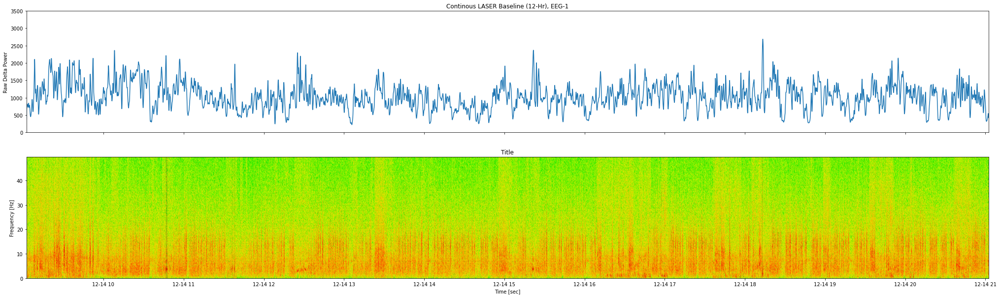

In [185]:
band='delta'
chan=1
y=3500
b, s = kp.plot_bp_and_spectro(clean['2ebl'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.set_title('Continous LASER Baseline (12-Hr), EEG-'+str(chan))
b.set_ylim(0,y)

(0.0, 3500.0)

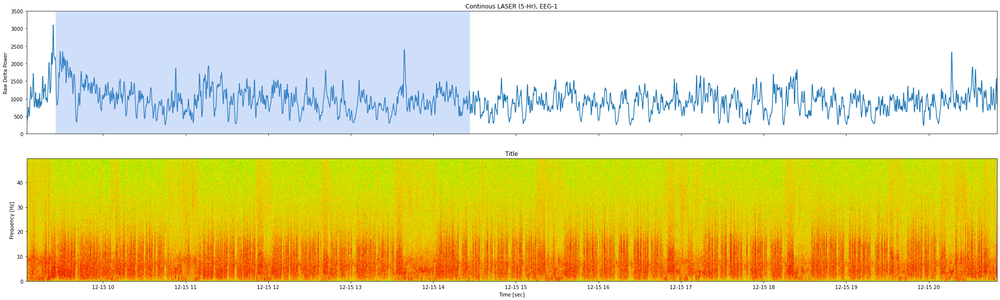

In [186]:
band='delta'
chan=1
y=3500
b, s = kp.plot_bp_and_spectro(clean['2e'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.axvspan(
    las[0],
    las[1],
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_title('Continous LASER (5-Hr), EEG-'+str(chan))
b.set_ylim(0,y)

(0.0, 3500.0)

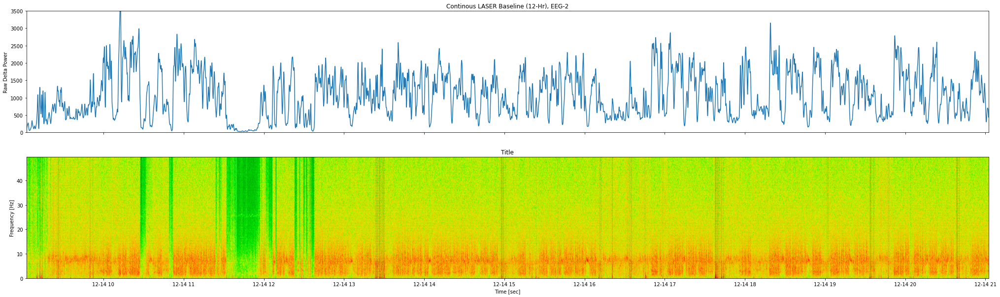

In [187]:
band='delta'
chan=2
y=3500
b, s = kp.plot_bp_and_spectro(clean['2ebl'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.set_title('Continous LASER Baseline (12-Hr), EEG-'+str(chan))
b.set_ylim(0,y)

(0.0, 3500.0)

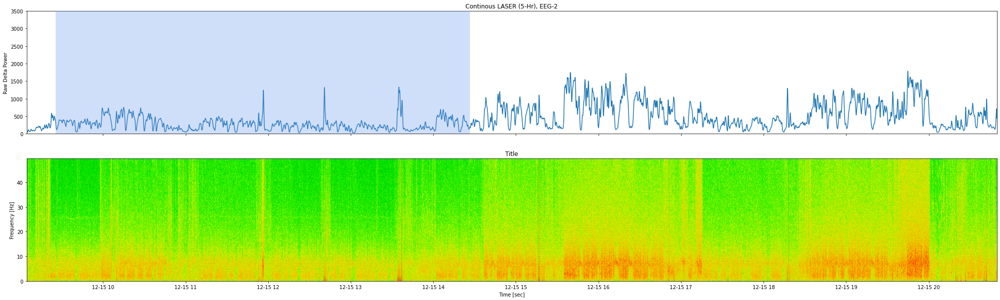

In [188]:
band='delta'
chan=2
y=3500
b, s = kp.plot_bp_and_spectro(clean['2e'], chan=chan, hyp=None, bp_def=bp_def, band=band)
b.axvspan(
    las[0],
    las[1],
    alpha=0.3,
    color='cornflowerblue',
    zorder=1000,
    ec="none",
)
b.set_title('Continous LASER (5-Hr), EEG-'+str(chan))
b.set_ylim(0,y)

# Output

In [190]:
! jupyter nbconvert ACHR_3.ipynb --output-dir='/Volumes/opto_loc/Data/ACHR_PROJECT_MATERIALS/ACHR_3/' --to=html --TemplateExporter.exclude_input=True -TagRemovePreprocessor.remove_cell_tags='hide' --allow-errors

[NbConvertApp] Converting notebook ACHR_3.ipynb to html
[NbConvertApp] Writing 35228679 bytes to /Volumes/opto_loc/Data/ACHR_PROJECT_MATERIALS/ACHR_3/ACHR_3.html


In [ ]:
! jupyter nbconvert ACHR_3.ipynb --to=html --TemplateExporter.exclude_input=True -TagRemovePreprocessor.remove_cell_tags='hide'